In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt

# Exploration Day20

In [3]:
D20_1 = sc.read_10x_mtx("../data/initial_10x_outputs/filtered_feature_bc_matrix-D20_1")

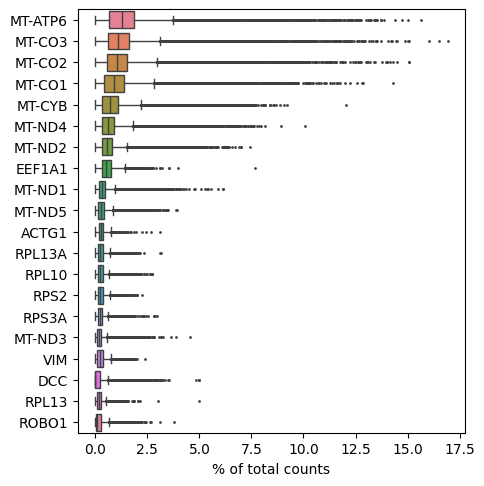

In [4]:
sc.pl.highest_expr_genes(D20_1, n_top=20)

#Basic filtering genes not expressed + cell with twoo few genes
sc.pp.filter_cells(D20_1, min_genes=200)
sc.pp.filter_genes(D20_1, min_cells=3)

## Distributions QC metrics for cells

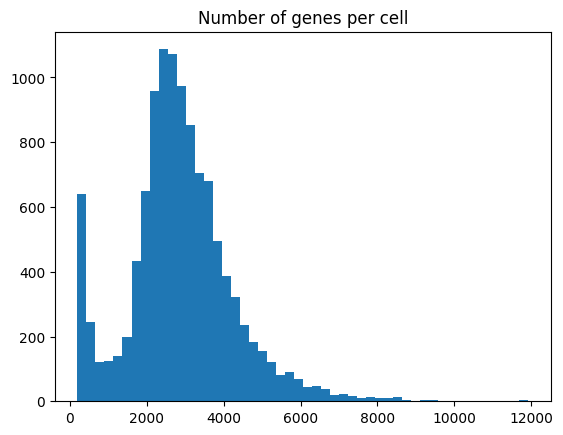

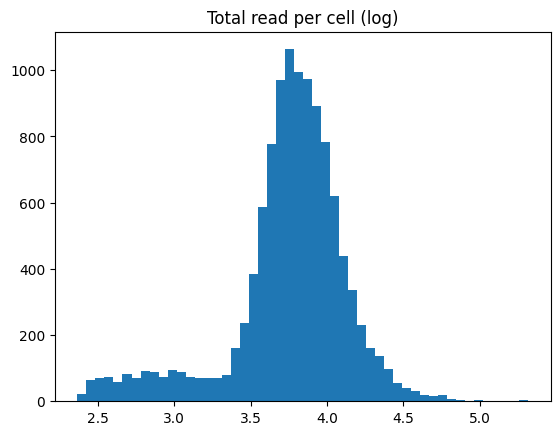

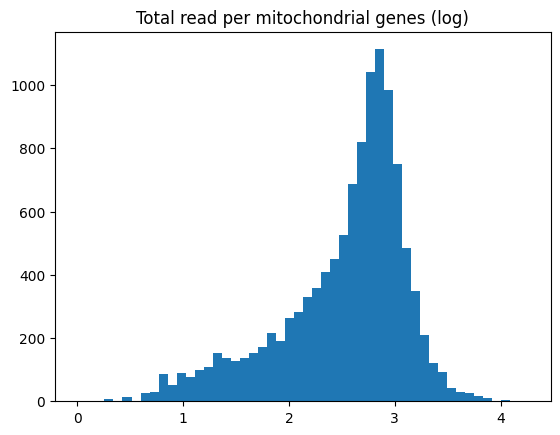

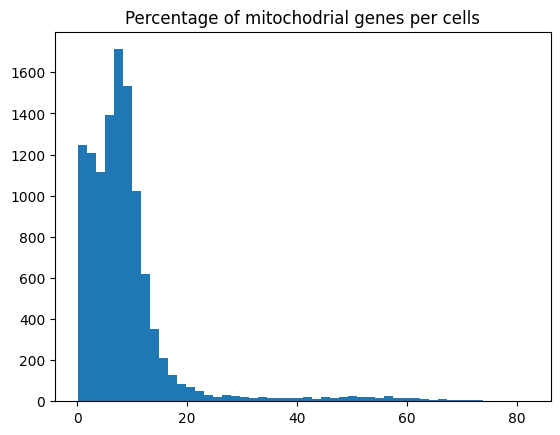

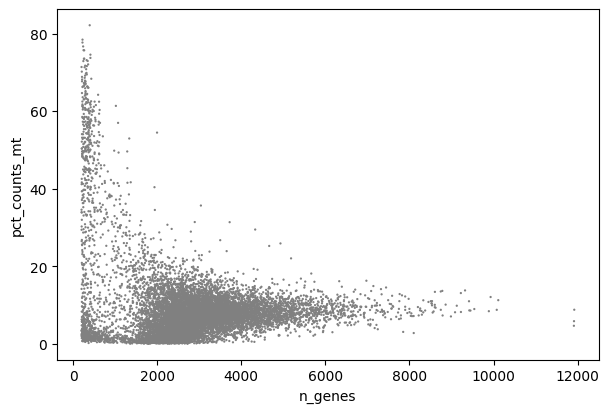

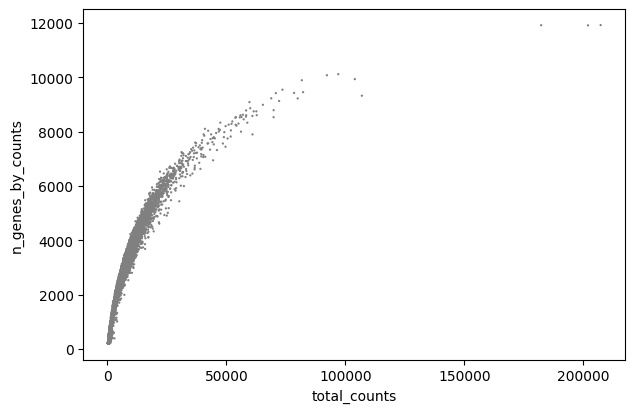

In [5]:
D20_1.var["mt"] = D20_1.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(
    D20_1, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

#Visualize distribution of cell metrics to define filtering thresholds
plt.hist(D20_1.obs.n_genes, bins=50)
plt.title("Number of genes per cell")
plt.show()

plt.hist(np.log10(D20_1.obs.total_counts), bins=50)
plt.title("Total read per cell (log)")
plt.show()

plt.hist(np.log10(D20_1.obs.total_counts_mt), bins=50)
plt.title("Total read per mitochondrial genes (log)")
plt.show()

plt.hist(D20_1.obs.pct_counts_mt, bins=50)
plt.title("Percentage of mitochodrial genes per cells")
plt.show()

sc.pl.scatter(D20_1, x="n_genes", y="pct_counts_mt")
sc.pl.scatter(D20_1, x="total_counts", y="n_genes_by_counts")

## Distributions QC metrics for genes

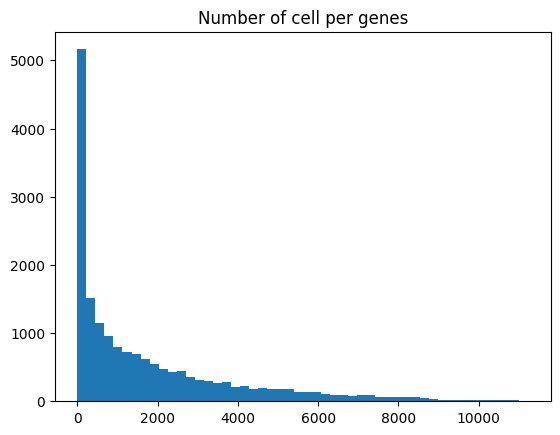

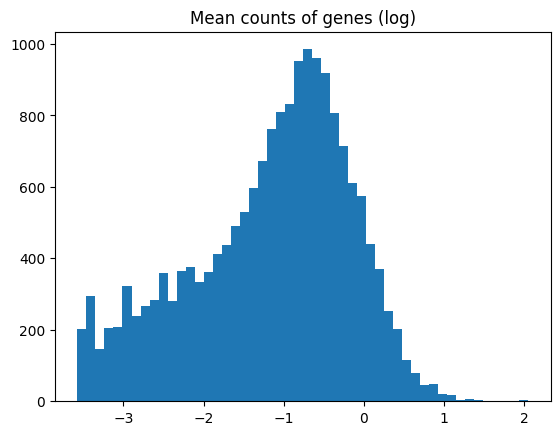

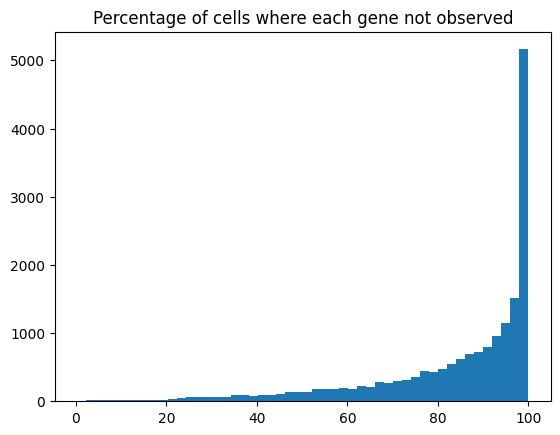

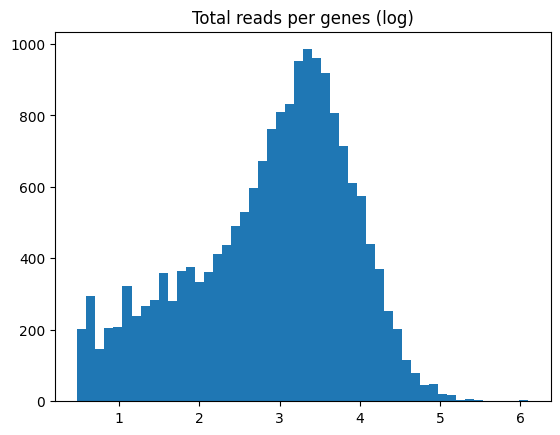

In [6]:
#Visualize distribution of genes metrics to define filtering thresholds
plt.hist(D20_1.var.n_cells, bins=50)
plt.title("Number of cell per genes")
plt.show()

plt.hist(np.log10(D20_1.var.mean_counts), bins=50)
plt.title("Mean counts of genes (log)")
plt.show()

plt.hist(D20_1.var.pct_dropout_by_counts, bins=50)
plt.title("Percentage of cells where each gene not observed")
plt.show()

plt.hist(np.log10(D20_1.var.total_counts), bins=50)
plt.title("Total reads per genes (log)")
plt.show()

## Filtering of cells

Remove the cell with extreme mitochondrial %.

Should we also remove the cells with very high number of genes -> removecell with > 6000 genes

Same but low number of genes??? (might be droplets with ambient RNA)

**-> do rest of pipeline and come back to this point**

Check for doublets and empty droplets



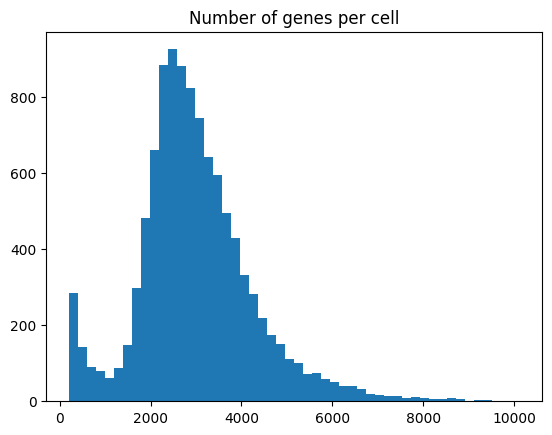

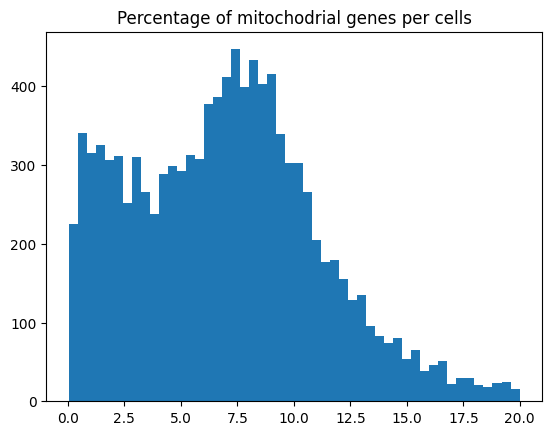

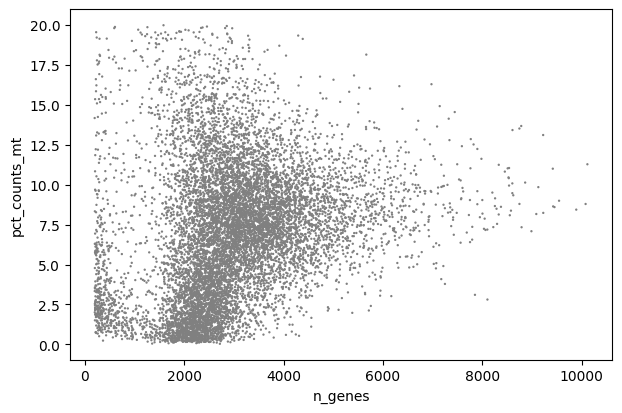

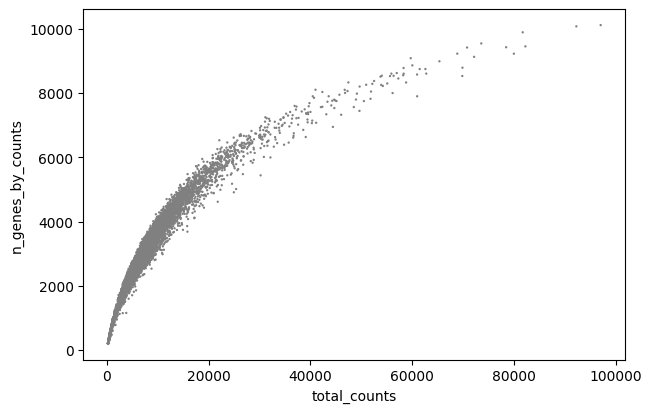

In [7]:
#Remove all cell with % mt > 20% + extreme total counts
D20_1 = D20_1[D20_1.obs.pct_counts_mt < 20]
D20_1 = D20_1[D20_1.obs.total_counts < 100000]

#Remove the cells with extreme number of features
#D20_1 = D20_1[D20_1.obs.n_genes < 6000]

plt.hist(D20_1.obs.n_genes, bins=50)
plt.title("Number of genes per cell")
plt.show()

plt.hist(D20_1.obs.pct_counts_mt, bins=50)
plt.title("Percentage of mitochodrial genes per cells")
plt.show()

sc.pl.scatter(D20_1, x="n_genes", y="pct_counts_mt")
sc.pl.scatter(D20_1, x="total_counts", y="n_genes_by_counts")

## Normalize the data

Each cell in scRNA-seq will have a differing number of reads associated with it. So to accurately compare expression between cells, it is necessary to normalize for sequencing depth.

In [8]:
sc.pp.normalize_per_cell(D20_1)
sc.pp.log1p(D20_1)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:523: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_n_counts] = counts_per_cell


## Identify the highly variables genes
Feature selection step, we keep only the highly variable genes to remove the noise in the data


In [9]:
D20_1.var.shape

(17919, 8)

In [10]:
sc.pp.highly_variable_genes(D20_1, min_mean=0.0125, max_mean=3, min_disp=0.5)
D20_1_HVG = D20_1[:, D20_1.var.highly_variable].copy()

#Scale each to unit variance 
sc.pp.scale(D20_1_HVG, max_value=10)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


## PCA 

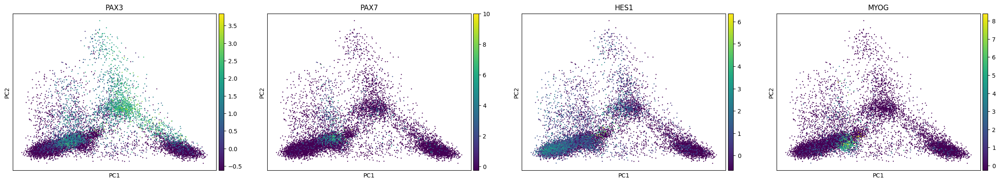

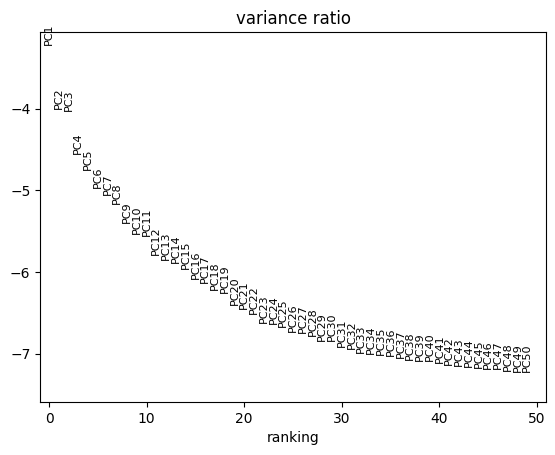

In [11]:
sc.tl.pca(D20_1_HVG, svd_solver="arpack")
sc.pl.pca(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG']) # HEYL, MYOD1

#Variance to pick number of PCs
sc.pl.pca_variance_ratio(D20_1_HVG, log=True, n_pcs=50)

## Creating low dim space embedding


Only cells with >20% of mithocondral genes

/Users/adorman/.local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


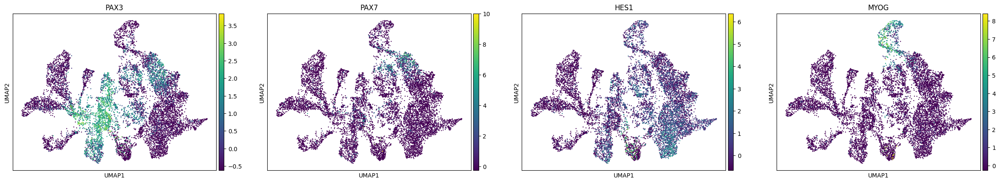

In [ ]:
sc.pp.neighbors(D20_1_HVG, n_neighbors=10, n_pcs=30)

sc.tl.umap(D20_1_HVG)
sc.pl.umap(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG'])

Cells >20% mitocondrial genes + total count > 100000

/Users/adorman/.local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


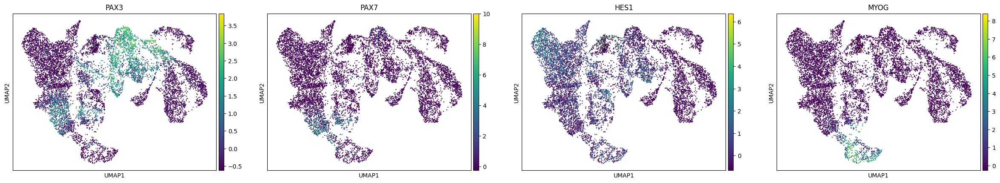

In [12]:
sc.pp.neighbors(D20_1_HVG, n_neighbors=10, n_pcs=30)

sc.tl.umap(D20_1_HVG)
sc.pl.umap(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG'])

Cells >20% mitocondrial genes + total count > 100000 + total genes > 6000

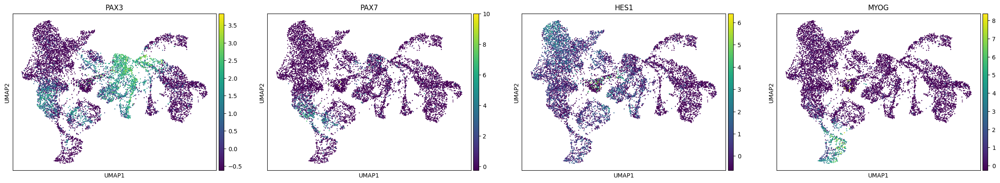

In [56]:
sc.pp.neighbors(D20_1_HVG, n_neighbors=10, n_pcs=30)

sc.tl.umap(D20_1_HVG)
sc.pl.umap(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG'])

## Clustering cells

Resolution range: 0.1 - 4, play around with this parameter to see which one makes more sense

Only remove 20% mitochondrial genes

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

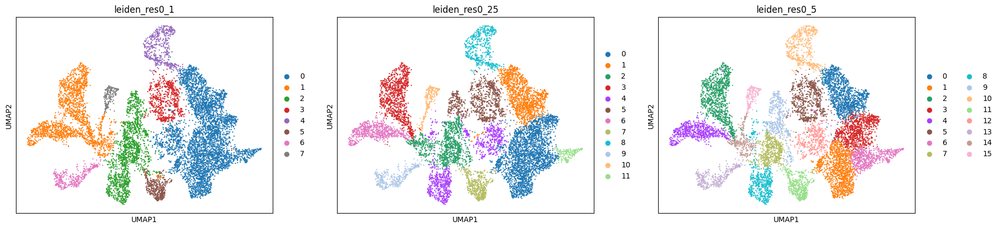

In [ ]:
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.1,
    random_state=0,
    key_added="leiden_res0_1"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.25,
    random_state=0,
    key_added="leiden_res0_25"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.5,
    random_state=0,
    key_added="leiden_res0_5"
)
sc.pl.umap(D20_1_HVG, color=["leiden_res0_1",'leiden_res0_25','leiden_res0_5'])

Remove >20% mitochrondrial genes + total counts > 100 000

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

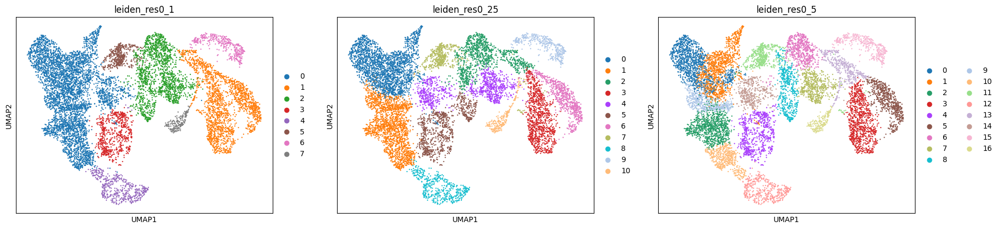

In [13]:
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.1,
    random_state=0,
    key_added="leiden_res0_1"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.25,
    random_state=0,
    key_added="leiden_res0_25"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.5,
    random_state=0,
    key_added="leiden_res0_5"
)
sc.pl.umap(D20_1_HVG, color=["leiden_res0_1",'leiden_res0_25','leiden_res0_5'])

Let's look where the cells with low/high numbers of features are

In [14]:
D20_1_HVG

AnnData object with n_obs × n_vars = 10626 × 3750
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden_res0_1', 'leiden_res0_25', 'leiden_res0_5'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_res0_1_colors', 'leiden_res0_25_colors', 'leiden_res0_5_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

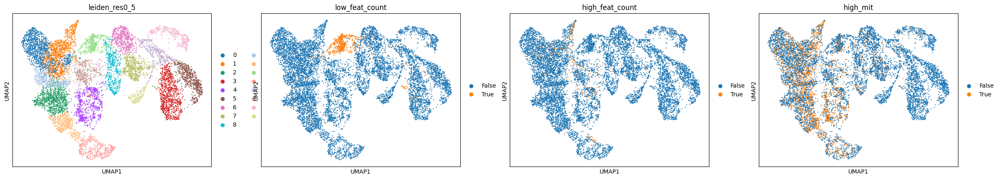

In [15]:
#Where are the low/high feature counts
D20_1_HVG.obs["low_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes < 1000)
D20_1_HVG.obs["high_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes > 6000)

#Where are the high mitochondrial percentage
D20_1_HVG.obs["high_mit"] = pd.Categorical(D20_1_HVG.obs.pct_counts_mt > 10)


sc.pl.umap(D20_1_HVG, color=['leiden_res0_5', 'low_feat_count',  'high_feat_count', 'high_mit'])

Remove >20% mitochrondrial genes + total counts > 100 000 + total genes > 6000

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

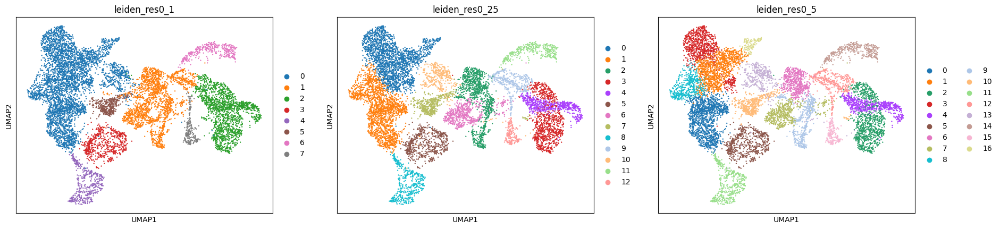

In [57]:
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.1,
    random_state=0,
    key_added="leiden_res0_1"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.25,
    random_state=0,
    key_added="leiden_res0_25"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.5,
    random_state=0,
    key_added="leiden_res0_5"
)
sc.pl.umap(D20_1_HVG, color=["leiden_res0_1",'leiden_res0_25','leiden_res0_5'])

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

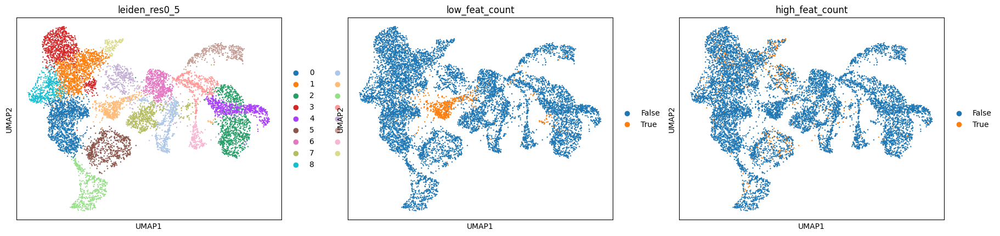

In [59]:
#Where are the low/high feature counts
D20_1_HVG.obs["low_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes < 1000)
D20_1_HVG.obs["high_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes > 5000)

sc.pl.umap(D20_1_HVG, color=['leiden_res0_5', 'low_feat_count',  'high_feat_count'])

## Find marker genes

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()


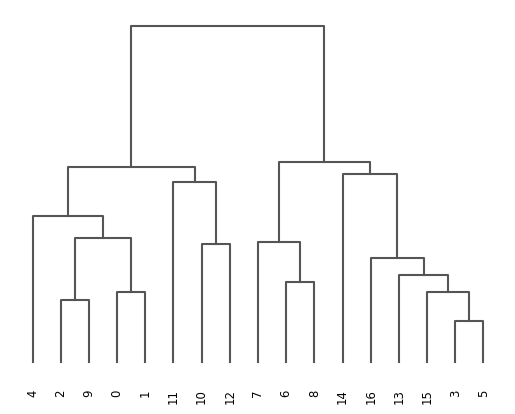

<Axes: >

In [16]:
sc.pl.dendrogram(D20_1_HVG, groupby='leiden_res0_5')

/Users/adorman/.local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_g

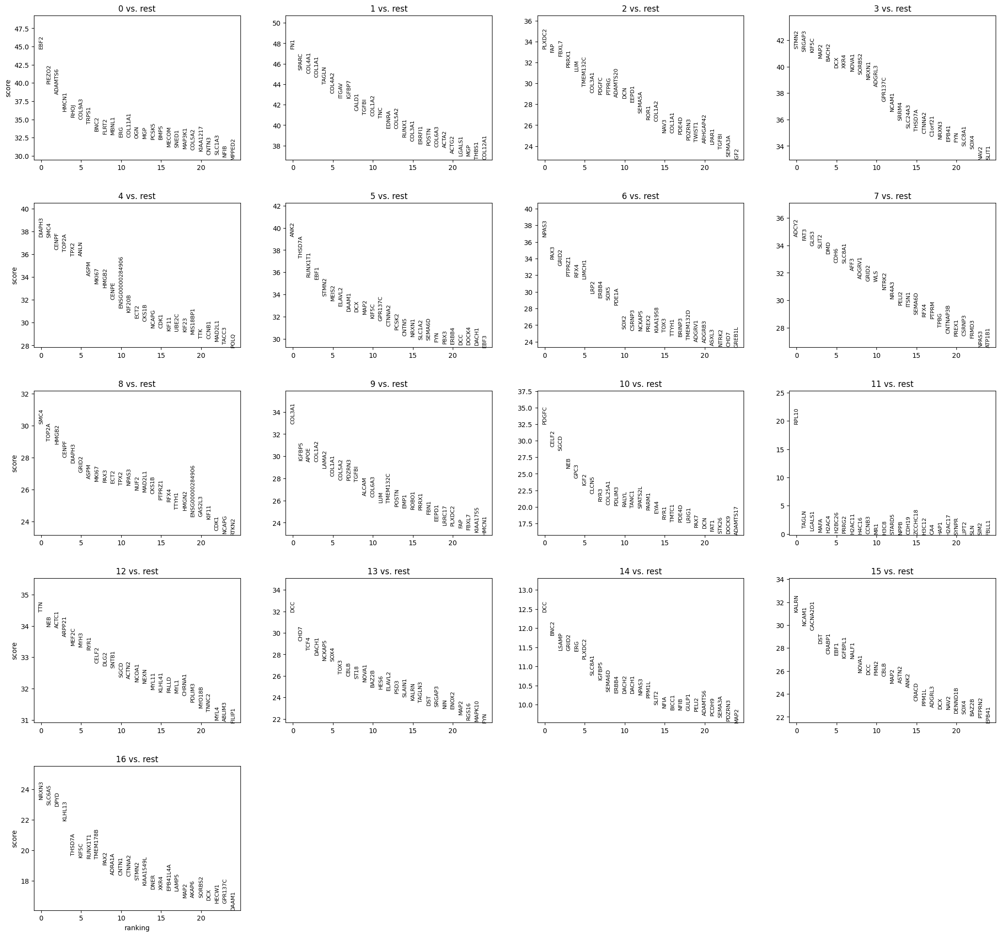

In [17]:
sc.tl.rank_genes_groups(D20_1_HVG, "leiden_res0_5", method="wilcoxon")
sc.pl.rank_genes_groups(D20_1_HVG, n_genes=25, sharey=False)

In [84]:
result = D20_1_HVG.uns["rank_genes_groups"]
groups = result["names"].dtype.names
results = pd.DataFrame(
    {
        group + "_" + key[:1]: result[key][group]
        for group in groups
        for key in ["names", "pvals"]
    }
)

results.head()

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,12_n,12_p,13_n,13_p,14_n,14_p,15_n,15_p,16_n,16_p
0,EBF2,0.000000e+00,FN1,0.0,PLXDC2,2.396502e-243,STMN2,0.0,DIAPH3,5.898287e-309,...,TTN,3.324369e-260,DCC,1.589760e-224,DCC,1.752998e-35,KALRN,2.057243e-213,NRXN3,1.133650e-120
1,PIEZO2,0.000000e+00,SPARC,0.0,FAP,4.948701e-239,SRGAP3,0.0,SMC4,3.876800e-307,...,NEB,3.523994e-253,CHD7,3.819302e-188,BNC2,3.339925e-32,NCAM1,1.305760e-197,SLC6A5,6.775173e-117
2,ADAMTS6,0.000000e+00,COL4A1,0.0,FBXL7,3.146907e-233,KIF5C,0.0,CENPF,5.778814e-290,...,ACTC1,1.355448e-252,TCF4,8.897345e-178,LSAMP,3.143464e-30,CACNA2D1,6.157177e-192,DPYD,3.918401e-116
3,HMCN1,1.568254e-286,COL1A1,0.0,PRRX1,6.966238e-219,MAP2,0.0,TOP2A,2.955705e-287,...,ARPP21,2.124701e-248,DACH1,3.208436e-172,GRID2,3.368006e-30,DST,9.075377e-178,KLHL13,8.461560e-107
4,RHOJ,1.724029e-273,TAGLN,0.0,LUM,2.456531e-213,BACH2,0.0,TPX2,7.589302e-282,...,MEF2C,1.870220e-244,NCKAP5,8.100002e-166,ERG,4.367979e-30,CRABP1,2.080619e-166,THSD7A,4.689307e-86


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

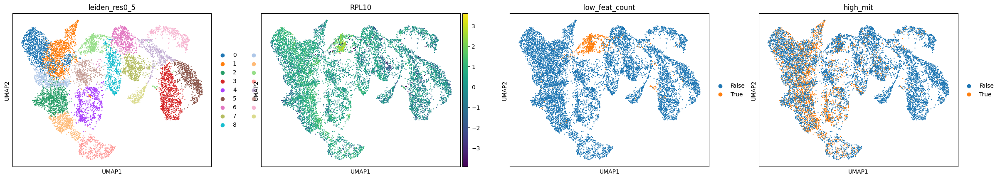

In [85]:
#cluster 11
sc.pl.umap(D20_1_HVG, color=['leiden_res0_5', 'RPL10', 'low_feat_count', 'high_mit'])

In [88]:
#find markers
results = D20_1_HVG.uns['rank_genes_groups']
out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                        results['scores'][group],
                                        results['pvals_adj'][group],
                                        results['logfoldchanges'][group],
                                        np.array([group] * len(results['names'][group])).astype('object'))).T))
markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])
D20_1_HVG.uns['markers'] = markers #save marker df to uns


In [118]:
#Create list of differently expressed genes for each cluster

for i in np.unique(markers['cluster']):
    ec_markers = D20_1_HVG.uns['markers']
    ec_markers = ec_markers[(ec_markers.cluster == i) & (ec_markers.pval_adj < 0.05)]
    ec_markers

    ec_markers['Gene'].to_csv('gene_list/cluster' + i + '.csv', header=False, index=False)

In [ ]:
#Use https://geneontology.org/ to see GO term enrichment

## Visualization of few genes

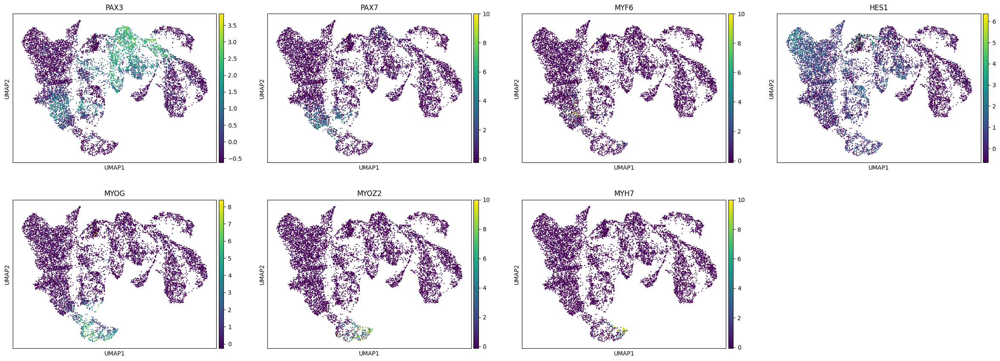

In [132]:
# Visualization TF markers
sc.pl.umap(D20_1_HVG, color=["PAX3",'PAX7','MYF6','HES1','MYOG','MYOZ2','MYH7'])

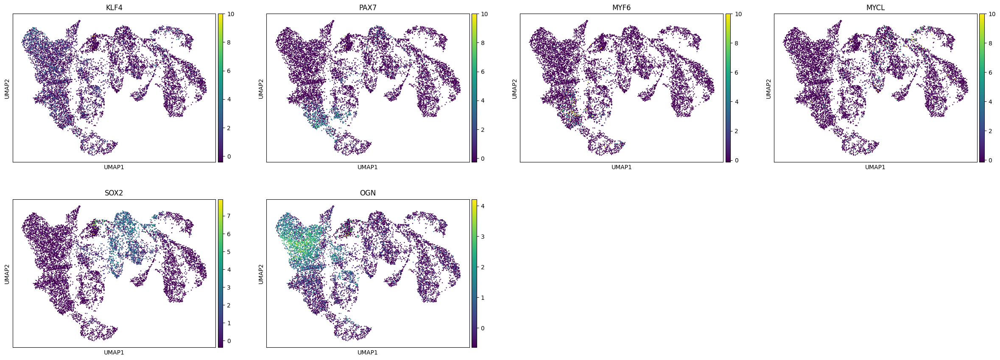

In [138]:
sc.pl.umap(D20_1_HVG, color=["KLF4",'PAX7','MYF6','MYCL','SOX2', 'OGN'])

In [141]:
D20_1_HVG.obs.leiden_res0_5


AAACAGCCAACCTAAT-1    10
AAACAGCCAAGGTAAC-1     8
AAACAGCCAATAACGA-1     9
AAACAGCCAATGCCTA-1    13
AAACAGCCACGAATTT-1     8
                      ..
TTTGTTGGTATTGGAT-1    13
TTTGTTGGTATTGGTG-1     6
TTTGTTGGTTATCGAG-1     3
TTTGTTGGTTTGCGCC-1     6
TTTGTTGGTTTGTGGA-1     8
Name: leiden_res0_5, Length: 10626, dtype: category
Categories (17, object): ['0', '1', '2', '3', ..., '13', '14', '15', '16']

## Remove possibly neuronal cell types


In [68]:
#Make a copy to use later
#D20_1_HVG_all = D20_1_HVG.copy()

clusters_remove = pd.Categorical(['3','4','5', '6','7','8', '13','14','15','16','11'])
cell_keep = D20_1_HVG_all.obs.index[~D20_1_HVG_all.obs.leiden_res0_5.isin(clusters_remove)]


In [69]:
D20_1 = sc.read_10x_mtx("../data/initial_10x_outputs/filtered_feature_bc_matrix-D20_1")


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


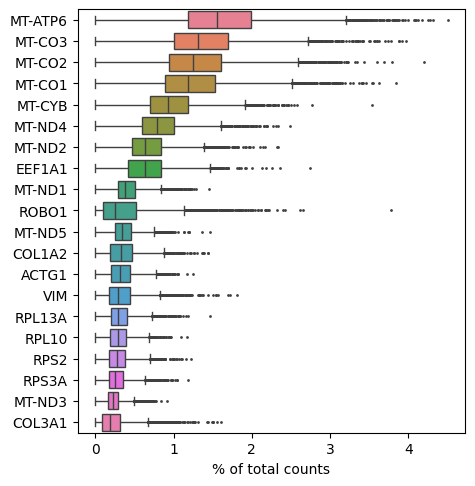

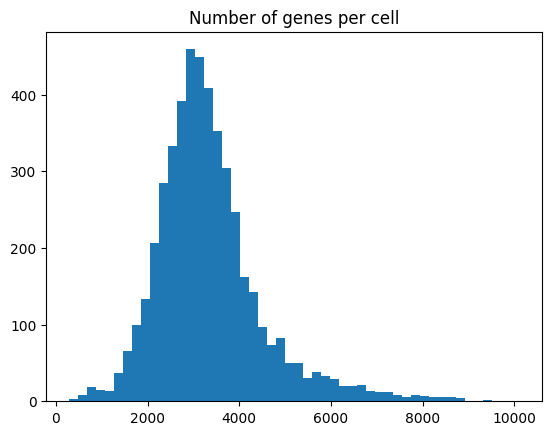

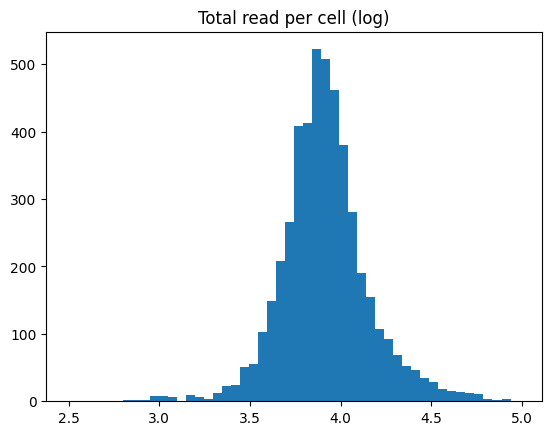

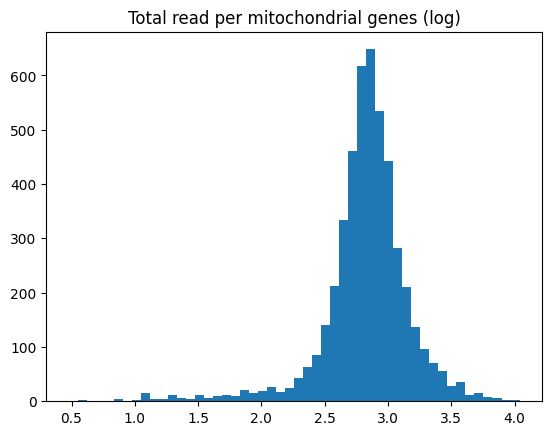

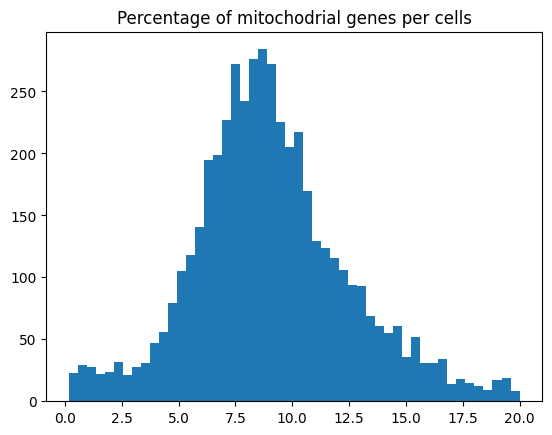

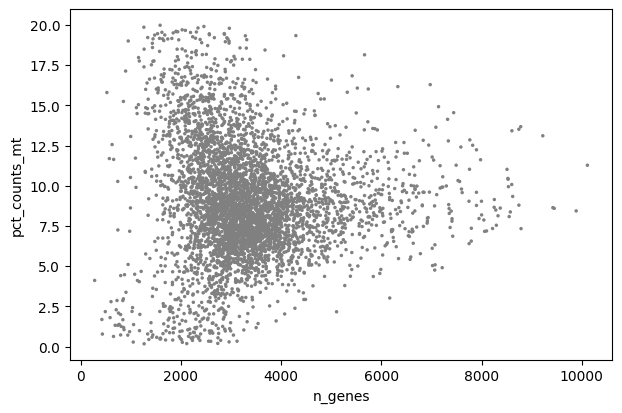

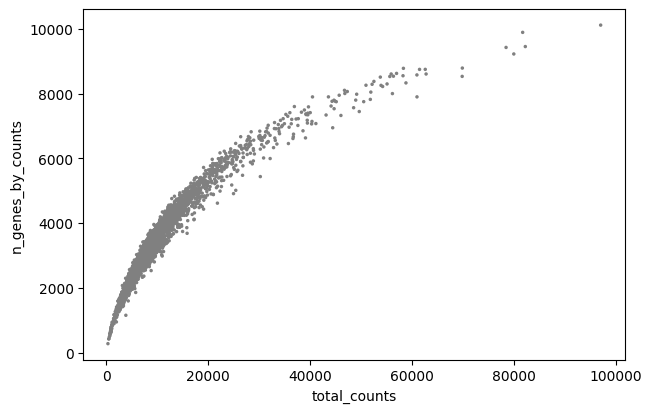

In [70]:
D20_1 = D20_1[D20_1.obs_names.isin(cell_keep)]

sc.pl.highest_expr_genes(D20_1, n_top=20)

#Basic filtering genes not expressed + cell with twoo few genes
sc.pp.filter_cells(D20_1, min_genes=200)
sc.pp.filter_genes(D20_1, min_cells=3)

D20_1.var["mt"] = D20_1.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(
    D20_1, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

#Visualize distribution of cell metrics to define filtering thresholds
plt.hist(D20_1.obs.n_genes, bins=50)
plt.title("Number of genes per cell")
plt.show()

plt.hist(np.log10(D20_1.obs.total_counts), bins=50)
plt.title("Total read per cell (log)")
plt.show()

plt.hist(np.log10(D20_1.obs.total_counts_mt), bins=50)
plt.title("Total read per mitochondrial genes (log)")
plt.show()

plt.hist(D20_1.obs.pct_counts_mt, bins=50)
plt.title("Percentage of mitochodrial genes per cells")
plt.show()

sc.pl.scatter(D20_1, x="n_genes", y="pct_counts_mt")
sc.pl.scatter(D20_1, x="total_counts", y="n_genes_by_counts")

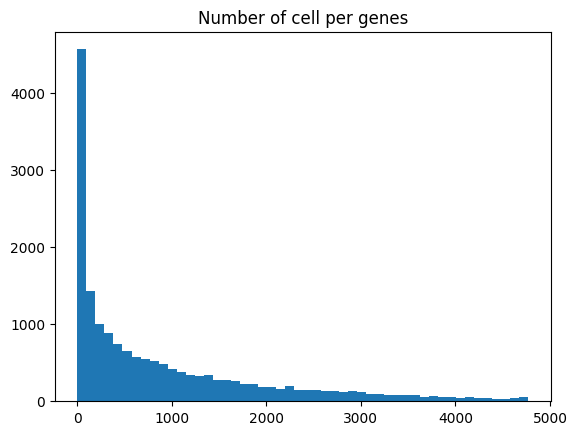

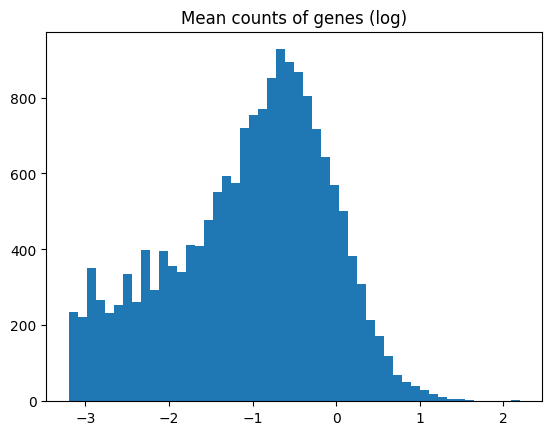

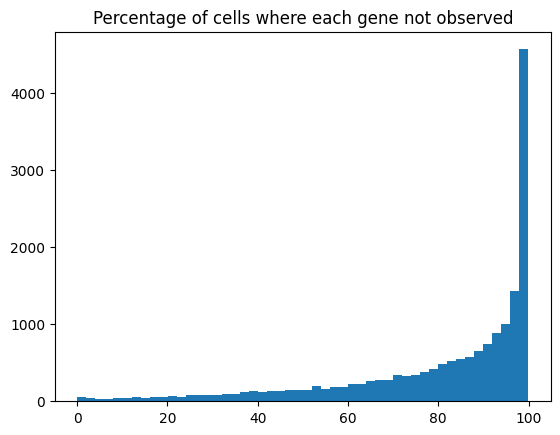

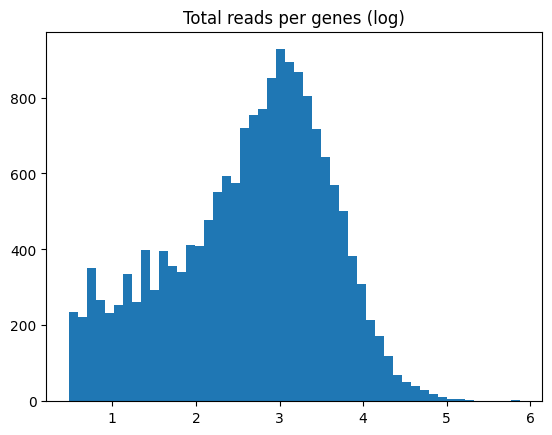

In [71]:
#Visualize distribution of genes metrics to define filtering thresholds
plt.hist(D20_1.var.n_cells, bins=50)
plt.title("Number of cell per genes")
plt.show()

plt.hist(np.log10(D20_1.var.mean_counts), bins=50)
plt.title("Mean counts of genes (log)")
plt.show()

plt.hist(D20_1.var.pct_dropout_by_counts, bins=50)
plt.title("Percentage of cells where each gene not observed")
plt.show()

plt.hist(np.log10(D20_1.var.total_counts), bins=50)
plt.title("Total reads per genes (log)")
plt.show()

In [72]:
sc.pp.normalize_per_cell(D20_1)
sc.pp.log1p(D20_1)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


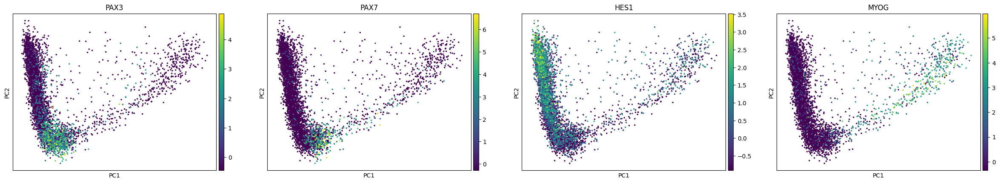

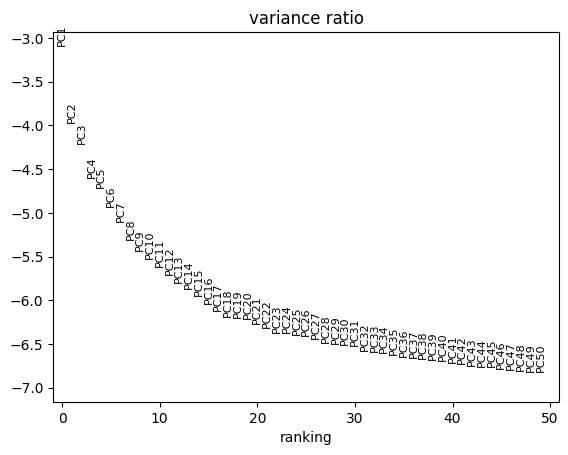

In [73]:
sc.pp.highly_variable_genes(D20_1, min_mean=0.0125, max_mean=3, min_disp=0.5)
D20_1_HVG = D20_1[:, D20_1.var.highly_variable].copy()

#Scale each to unit variance 
sc.pp.scale(D20_1_HVG, max_value=10)

sc.tl.pca(D20_1_HVG, svd_solver="arpack")
sc.pl.pca(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG']) # HEYL, MYOD1

#Variance to pick number of PCs
sc.pl.pca_variance_ratio(D20_1_HVG, log=True, n_pcs=50)

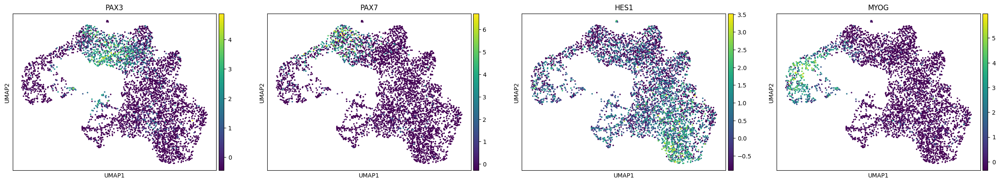

In [74]:
sc.pp.neighbors(D20_1_HVG, n_neighbors=10, n_pcs=30)

sc.tl.umap(D20_1_HVG)
sc.pl.umap(D20_1_HVG, color=["PAX3",'PAX7','HES1','MYOG'])

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

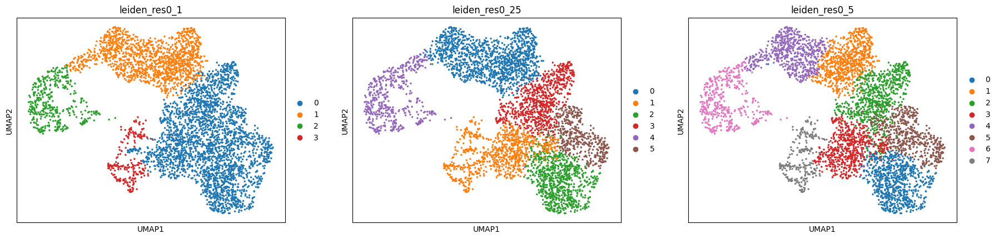

In [115]:
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.1,
    random_state=0,
    key_added="leiden_res0_1"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.25,
    random_state=0,
    key_added="leiden_res0_25"
)
sc.tl.leiden(
    D20_1_HVG,
    resolution=0.5,
    random_state=0,
    key_added="leiden_res0_5"
)
sc.pl.umap(D20_1_HVG, color=["leiden_res0_1",'leiden_res0_25','leiden_res0_5'])

In [118]:
#Pick res 0.5, put merge cluster
D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='7']='3'
D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='8']='3'

# Remove the small cluster 9
D20_1_HVG = D20_1_HVG[D20_1_HVG.obs['leiden_res0_5']!='9']

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_85862/1093878994.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='7']='3'
/var/folders/nx/fx90wvl146lcdkglfty5_wr4q

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


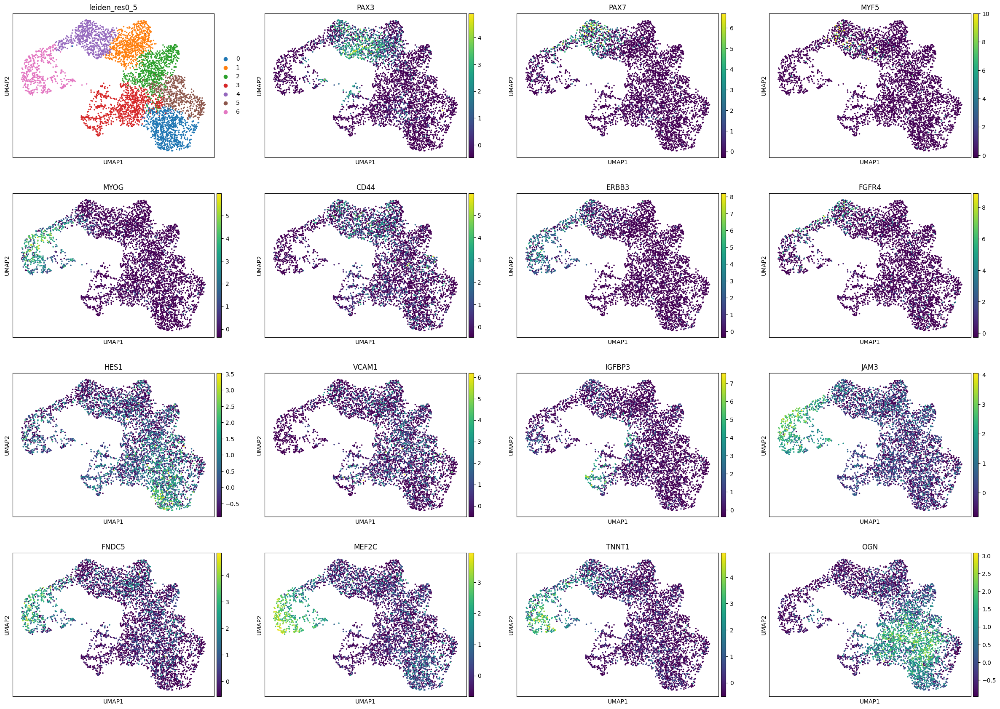

In [120]:
sc.pl.umap(D20_1_HVG, color=['leiden_res0_5', "PAX3",'PAX7','MYF5','MYOG','CD44', 'ERBB3','FGFR4','HES1','VCAM1','IGFBP3','JAM3','FNDC5','MEF2C','TNNT1','OGN'])

In [99]:
D20_1_HVG.var_names.to_series().to_csv('test.csv', index=False)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

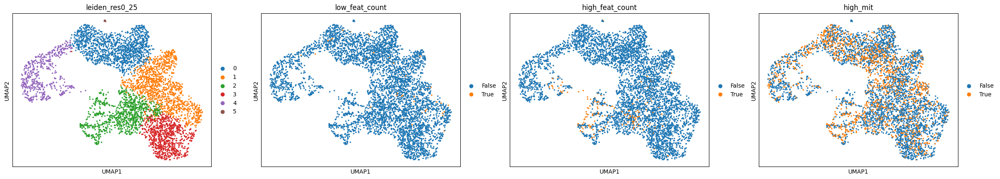

In [86]:
#Where are the low/high feature counts
D20_1_HVG.obs["low_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes < 1000)
D20_1_HVG.obs["high_feat_count"] = pd.Categorical(D20_1_HVG.obs.n_genes > 6000)

#Where are the high mitochondrial percentage
D20_1_HVG.obs["high_mit"] = pd.Categorical(D20_1_HVG.obs.pct_counts_mt > 10)


sc.pl.umap(D20_1_HVG, color=['leiden_res0_25', 'low_feat_count',  'high_feat_count', 'high_mit'])

/Users/adorman/.local/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/tools/_rank_g

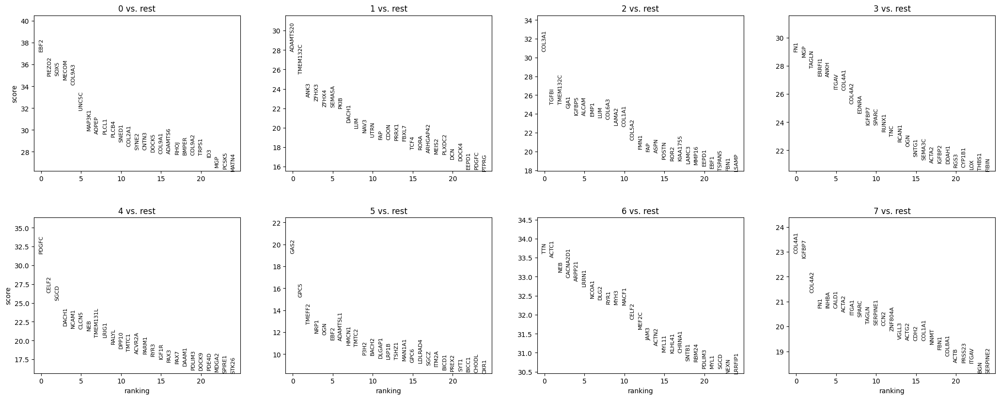

In [117]:
sc.tl.rank_genes_groups(D20_1_HVG, "leiden_res0_5", method="wilcoxon")
sc.pl.rank_genes_groups(D20_1_HVG, n_genes=25, sharey=False)

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


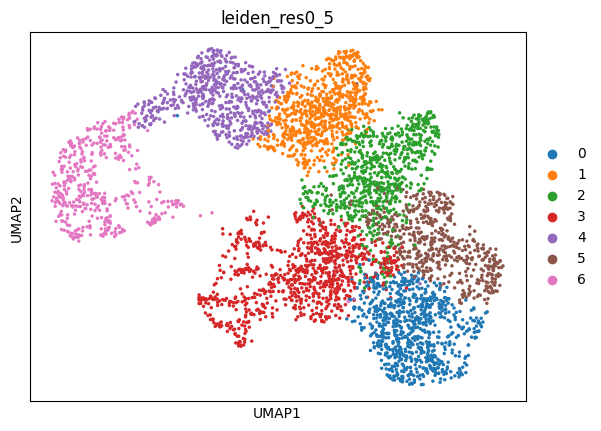

/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


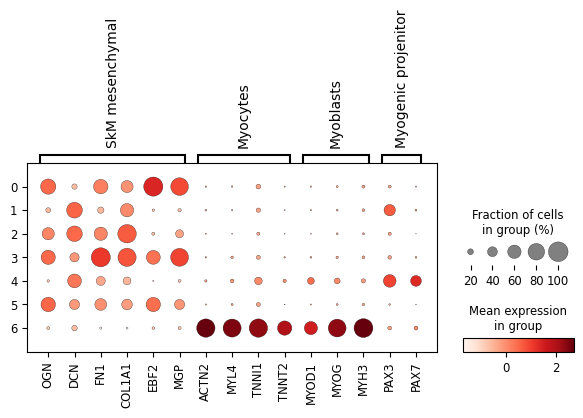

In [125]:
marker_genes = {
    "SkM mesenchymal": ["OGN",'DCN','FN1','COL1A1','EBF2','MGP'],
    "Myocytes": ["ACTN2", "MYL4", "TNNI1",'TNNT2'],
    "Myoblasts": ['MYOD1','MYOG','MYH3'],
    "Myogenic projenitor": ['PAX3','PAX7']
}

sc.pl.umap(D20_1_HVG, color='leiden_res0_5')
sc.pl.dotplot(D20_1_HVG, marker_genes, groupby='leiden_res0_5')

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_85862/205477968.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='2']='0'
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qn

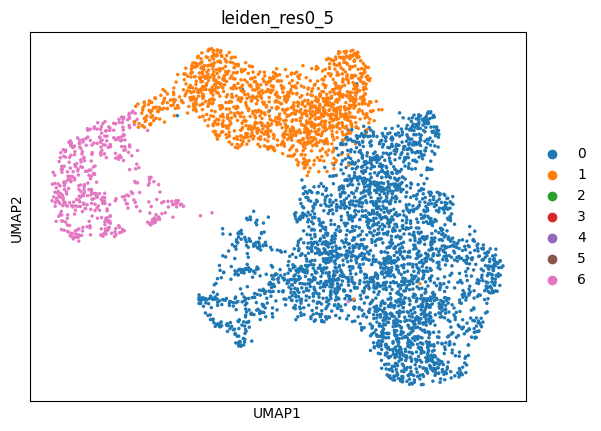

In [127]:
#Fuse the clusters into fist rough cell types
D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='2']='0'
D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='3']='0'
D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='5']='0'


D20_1_HVG.obs['leiden_res0_5'][D20_1_HVG.obs['leiden_res0_5']=='4']='1'

sc.pl.umap(D20_1_HVG, color='leiden_res0_5')


In [128]:
#find markers
results = D20_1_HVG.uns['rank_genes_groups']
out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                        results['scores'][group],
                                        results['pvals_adj'][group],
                                        results['logfoldchanges'][group],
                                        np.array([group] * len(results['names'][group])).astype('object'))).T))
markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])
D20_1_HVG.uns['markers'] = markers #save marker df to uns

for i in pd.Categorical(['0','1','6']):
    ec_markers = D20_1_HVG.uns['markers']
    ec_markers = ec_markers[(ec_markers.cluster == i) & (ec_markers.pval_adj < 0.05)]
    ec_markers

    ec_markers['Gene'].to_csv('gene_list/cluster' + i + '_ms.csv', header=False, index=False)


/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_85862/2711231240.py:11: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  D20_1_HVG.uns['markers'] = markers #save marker df to uns


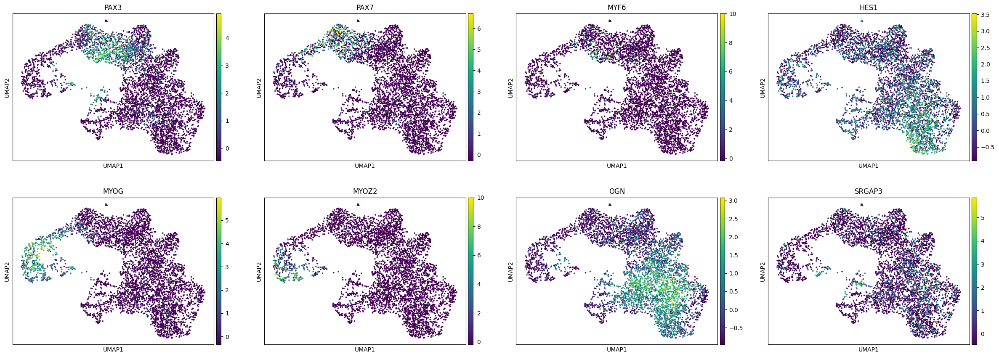

In [79]:
#Neuron markers: 'MAP1B','MAP2'

In [65]:
#Get name of cell that seems to be neuron here and see in representation of all cells
clusters_interest = pd.Categorical(['2','4'])
cell_neuron = D20_1_HVG.obs.index[D20_1_HVG.obs.leiden_res0_1.isin(clusters_interest)]


/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/adorman/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/adorman/.local/

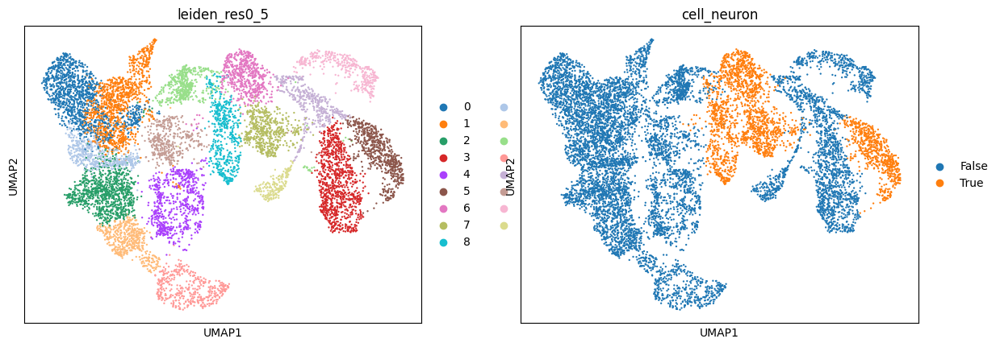

In [54]:
sc.pl.umap(D20_1_HVG_all, color=["leiden_res0_5","cell_neuron"])